# Space Invaders

In [8]:
# imports
import gym
import matplotlib.pyplot as plt
%matplotlib inline

# for getting the videos
from matplotlib import rc
import matplotlib.animation as animation
rc('animation', html='jshtml')

# getting the evolutionary strategies
import ray.rllib.agents.es as es
# import subprocess to copy the checkpoints
import subprocess
import pickle
from ray import tune
import ray

import pandas as pd

## Random movements

In [10]:
env = gym.make('SpaceInvaders-v4')

obs, info = env.reset(return_info=True)

vid = []
# some inspiration from https://www.gymlibrary.ml/content/api/
for _ in range(1000):   
    obs, reward, done, info = env.step(env.action_space.sample())
    vid.append(env.render(mode="rgb_array"))
    if done:
        break
env.close()

# using code from Computer vision lab 5, animation
fig, ax = plt.subplots()
def frame(i: int):
    """Render a frame of video"""
    # dispose of the last frame
    ax.clear()
    # get rid of the axis labels
    ax.axis('off')
    fig.tight_layout()
    # render the agent's view
    return ax.imshow(vid[i])

# build up the video
anim = animation.FuncAnimation(fig, frame, frames=len(vid))
# dispose of the graph object so that the last frame of the video isn't returned
plt.close()

# set the path to the ffmpeg program (install it using apt-get install ffmpeg, then use which ffmpeg to get where it installed to)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

writervideo = animation.FFMpegWriter(fps=30) # from https://www.geeksforgeeks.org/how-to-save-matplotlib-animation/

anim.save('videos/SpaceInvadersRandom.mp4', writer=writervideo)
anim

## Evolutionary Strategies

In [4]:
# get the es config
config = es.DEFAULT_CONFIG.copy()

config['framework'] = 'torch'

# stop it from checking the environment
config['disable_env_checking'] = True
# suppress an error
#config['reuse_actors'] = True
config['env'] = 'SpaceInvaders-v4'
config['num_workers'] = 5

In [ ]:
ray.init(num_cpus=6)
# use tune (Docker killed off the container at )
stop = {
    "episode_reward_mean": 500,
    "training_iteration": 60,
}
# using code inspired from https://github.com/ray-project/ray/blob/master/rllib/examples/inference_and_serving/policy_inference_after_training.py
results = tune.run(
    "ES",
    config=config,
    stop=stop,
    verbose=2,
    checkpoint_freq=1,
    checkpoint_at_end=True,
    #resources_per_trial={"cpu": 6, "gpu": 0},
    #resources_per_trial=tune.PlacementGroupFactory([{"cpu": 6, "gpu": 0}]),
)
# completed training
checkpoint = results.get_last_checkpoint()
# copy the checkpoints to file
subprocess.run(['cp', checkpoint, 'data/SpaceInvadersES/tune/'], stderr=subprocess.PIPE)
subprocess.run(['cp', checkpoint + '.tune_metadata', 'data/SpaceInvadersES/tune/'], stderr=subprocess.PIPE)
ray.shutdown()

In [ ]:
subprocess.run(['cp', '/ray_results/ES/ES_SpaceInvaders-v4_e989d_00000_0_2022-04-22_07-57-53/progress.csv', 'data/SpaceInvadersES/tune/'], stderr=subprocess.PIPE)

In [ ]:
trainer = es.ESTrainer(config, env='SpaceInvaders-v4')
mean_reward = []
for ep in range(25):
    result = trainer.train()
    print(f"Episode {ep}, mean reward: {result['episode_reward_mean']}")
    checkpoint = trainer.save()
    # copy the checkpoints to file
    subprocess.run(['cp', checkpoint, 'data/SpaceInvadersES/'], stderr=subprocess.PIPE)
    subprocess.run(['cp', checkpoint + '.tune_metadata', 'data/SpaceInvadersES/'], stderr=subprocess.PIPE)
    # append the rewards
    mean_reward.append(result['episode_reward_mean'])
    # save the rewards to file
    with open('data/SpaceInvadersRewards.pkl', 'wb') as f:
        pickle.dump(mean_reward, f)

## Analyse the data

In [ ]:
# instanciate the Evolutionary Strategies model
trainer = es.ESTrainer(config, env='SpaceInvaders-v4')
# load the model weights from the checkpoint
trainer.restore('data/SpaceInvadersES/tune/checkpoint-55')

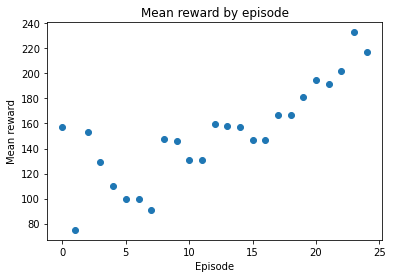

In [29]:
# Get the mean reward data back from the pickled array
# open a handle to the pickle file in read bytes mode. Use with so that we don't have to call the close function
with open('data/SpaceInvadersRewards.pkl', 'rb') as f:
    # use pickle to read back the data into the array
    mean_reward = pickle.load(f)

# graph the data. Use the list, range and len functions chained together to create the index
plt.scatter(list(range(len(mean_reward))), mean_reward)
# label the axes
plt.xlabel('Episode')
plt.ylabel('Mean reward')
plt.title('Mean reward by episode')
plt.show()

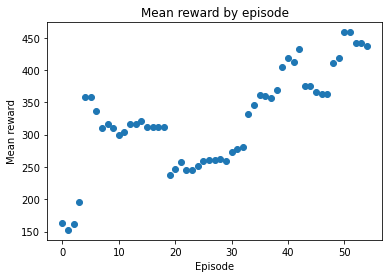

In [9]:
# graph the output from Tune
# get the data back
df = pd.read_csv('data/SpaceInvadersES/tune/progress.csv')
# make the graph
plt.scatter(df.index, df['episode_reward_mean'])
# label the axes
plt.xlabel('Episode')
plt.ylabel('Mean reward')
plt.title('Mean reward by episode')
plt.show()

In [7]:
# Video of the agent playing Space Invaders
total_reward = 0
done = False
env = gym.make('SpaceInvaders-v4')
obs = env.reset()

# store the data for the video
scene = []
total_rewards = []

while not done:
    # work out the next action to take
    action = trainer.compute_single_action(obs)
    # take the next action
    obs, reward, done, _ = env.step(action)
    # add to the episode reward
    total_reward += reward
    total_rewards.append(total_reward)
    # get the render of the scene and append to the array
    scene.append(env.render(mode="rgb_array"))

# using code from Computer vision lab 5, animation
fig, ax = plt.subplots()

def frame_from_agent(i: int):
    """Render a frame of the video"""
    # wipe the last frame
    ax.clear()
    # get rid of the axis labels
    ax.axis('off')
    # render the image
    plot = ax.imshow(scene[i])
    # show the current total reward
    ax.set_title(f"Reward: {total_rewards[i]}")
    return plot
# build the video
anim = animation.FuncAnimation(fig, frame_from_agent, frames=len(scene))

# set the path to the ffmpeg program (install it using apt-get install ffmpeg, then use which ffmpeg to get where it installed to)
plt.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

writervideo = animation.FFMpegWriter(fps=30) # from https://www.geeksforgeeks.org/how-to-save-matplotlib-animation/

anim.save('videos/SpaceInvaders2.mp4', writer=writervideo)

# dispose of the graph object
plt.close()
# show the video
anim